# Problem:

   The problem topic of interest is to explore and visualize the impacts of different factors on house market pricing. Also, the interest is to find out most important factors that can effect the price of a house along with highlighting some factors which can be regarded as non-significant.

#  Importance to stakeholders :

   Currently, there is substantial endeavor in developing machine learning models for predicting the house market pricing for real estate investors and owners. This work will contribute to the effort by making the understanding easier on significance of data collection of different features before model building focussing such interests. The research will also help the data scientists working in the field to understand the feature factors more distinctly and explain to the stakeholders more intuitively.

#  Research Question 1 :

   What are the most imporant features effecting the house market pricing?

#  Research Question 2 :

   Suggest some features which does not have significant effect on house pricing?

# Research Question 3 :

  Suggest some features that partially effect on the change of price of real estate buildings?

   

# Dataset :
  The dataset collected for the research goal was from "Ames Housing company, Iowa" which includes geographical and structural information of about 2930 (in total) sample houses along with their construction and sale period in the form of 79 explanatory features (Exlcluding 'ID' & 'Order'). The pricing of the respective houses are provided in the 'SalePrice' coloumn of the 'train.csv' dataset but not included in the 'test.csv' dataset. The 'SalePrice' column of the 'test.csv' dataset is separately available in another file 'target.csv' which is usually utilized for measuring testing accuracy of the predicted model for house pricing market. Some of the features of the dataset are explicitly sparse and thus fail to provide useful information for those samples. Thus, the dataset needs to be cleaned and preprocessed before using it for visualization/learning.

  # Read, Clean and Preprocess Data :

  At first, we read the data from both **'train.csv'** and **'test.csv'** and store it into two respective dataframes **train** and **test**.

In [213]:
import pandas as pd

train = pd.read_csv('train.csv')
test = pd.read_csv('test.csv')
# train.head()

# print(df.shape)

pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)


print(train.shape)


print(test.shape)

train

(2197, 82)
(733, 81)


,Order,PID,MS SubClass,MS Zoning,Lot Frontage,Lot Area,Street,Alley,Lot Shape,Land Contour,Utilities,Lot Config,Land Slope,Neighborhood,Condition 1,Condition 2,Bldg Type,House Style,Overall Qual,Overall Cond,Year Built,Year Remod/Add,Roof Style,Roof Matl,Exterior 1st,Exterior 2nd,Mas Vnr Type,Mas Vnr Area,Exter Qual,Exter Cond,Foundation,Bsmt Qual,Bsmt Cond,Bsmt Exposure,BsmtFin Type 1,BsmtFin SF 1,BsmtFin Type 2,BsmtFin SF 2,Bsmt Unf SF,Total Bsmt SF,Heating,Heating QC,Central Air,Electrical,1st Flr SF,2nd Flr SF,Low Qual Fin SF,Gr Liv Area,Bsmt Full Bath,Bsmt Half Bath,Full Bath,Half Bath,Bedroom AbvGr,Kitchen AbvGr,Kitchen Qual,TotRms AbvGrd,Functional,Fireplaces,Fireplace Qu,Garage Type,Garage Yr Blt,Garage Finish,Garage Cars,Garage Area,Garage Qual,Garage Cond,Paved Drive,Wood Deck SF,Open Porch SF,Enclosed Porch,3Ssn Porch,Screen Porch,Pool Area,Pool QC,Fence,Misc Feature,Misc Val,Mo Sold,Yr Sold,Sale Type,Sale Condition,SalePrice
0,534,531363010,20,RL,80.0,9605,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,SawyerW,Norm,Norm,1Fam,1Story,7,6,2007,2007,Gable,CompShg,VinylSd,VinylSd,None,0.0,Gd,TA,PConc,Gd,TA,No,Unf,0.0,Unf,0.0,1218.0,1218.0,GasA,Ex,Y,SBrkr,1218,0,0,1218,0.0,0.0,1,1,3,1,Gd,6,Typ,0,NaN,Detchd,2007.0,RFn,2.0,576.0,TA,TA,Y,0,178,0,0,0,0,NaN,NaN,NaN,0,4,2009,WD,Normal,159000
1,803,906203120,20,RL,90.0,14684,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,SawyerW,Norm,Norm,1Fam,1Story,7,7,1990,1991,Hip,CompShg,HdBoard,HdBoard,BrkFace,234.0,Gd,TA,CBlock,Gd,TA,Mn,ALQ,485.0,BLQ,177.0,1496.0,2158.0,GasA,Gd,Y,SBrkr,2196,0,0,2196,0.0,0.0,2,0,3,1,Gd,7,Typ,1,TA,Attchd,1990.0,RFn,3.0,701.0,TA,TA,Y,84,70,0,0,0,0,NaN,NaN,NaN,0,6,2009,WD,Normal,271900
2,956,916176030,20,RL,NaN,14375,Pave,NaN,IR1,Lvl,NoSeWa,CulDSac,Gtl,Timber,Norm,Norm,1Fam,SLvl,6,6,1958,1958,Gable,CompShg,HdBoard,HdBoard,BrkFace,541.0,TA,TA,CBlock,TA,TA,No,GLQ,111.0,Rec,354.0,354.0,819.0,GasA,Gd,Y,FuseA,1344,0,0,1344,0.0,1.0,1,0,3,1,Gd,7,Typ,1,Gd,Basment,1958.0,RFn,2.0,525.0,TA,TA,Y,0,118,0,0,233,0,NaN,NaN,NaN,0,1,2009,COD,Abnorml,137500
3,460,528180130,120,RL,48.0,6472,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NridgHt,Norm,Norm,TwnhsE,1Story,9,5,2008,2008,Hip,CompShg,VinylSd,VinylSd,BrkFace,500.0,Ex,TA,PConc,Ex,TA,No,Unf,0.0,Unf,0.0,1451.0,1451.0,GasA,Ex,Y,SBrkr,1456,0,0,1456,0.0,0.0,2,0,2,1,Ex,6,Typ,1,Gd,Attchd,2008.0,RFn,2.0,539.0,TA,TA,Y,192,42,0,0,0,0,NaN,NaN,NaN,0,4,2009,WD,Normal,248500
4,487,528290030,80,RL,61.0,9734,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,RRAn,Norm,1Fam,SLvl,7,5,2004,2004,Gable,CompShg,VinylSd,VinylSd,None,0.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,241.0,Rec,113.0,30.0,384.0,GasA,Ex,Y,SBrkr,744,630,0,1374,0.0,0.0,2,1,3,1,Gd,7,Typ,0,NaN,BuiltIn,2004.0,Fin,2.0,400.0,TA,TA,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,5,2009,WD,Normal,167000
5,1965,535453150,20,RL,70.0,7315,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,6,1958,1958,Hip,CompShg,BrkFace,BrkFace,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,625.0,Unf,0.0,545.0,1170.0,GasA,TA,Y,SBrkr,1170,0,0,1170,0.0,1.0,1,0,3,1,TA,6,Typ,1,TA,Attchd,1958.0,RFn,1.0,338.0,TA,TA,Y,0,0,0,0,225,0,NaN,NaN,NaN,0,3,2007,WD,Normal,140000
6,681,535452090,20,RL,71.0,7350,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,6,1958,1958,Hip,CompShg,BrkFace,BrkFace,None,0.0,TA,TA,CBlock,TA,TA,No,Unf,0.0,Unf,0.0,1041.0,1041.0,GasA,Gd,Y,SBrkr,1041,0,0,1041,0.0,0.0,1,0,3,1,TA,6,Typ,0,NaN,Attchd,1958.0,RFn,1.0,294.0,TA,TA,Y,0,0,0,0,0,0,NaN,GdWo,NaN,0,3,2009,WD,Normal,128000
7,1566,914467050,60,RL,NaN,11050,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,Mn,Unf,0.0,Unf,0.0,910.0,910.0,GasA,Ex,Y,SBrkr,910,910,0,1820,0.0,0.0,2,1,3,1,Gd,8,Typ,1,TA,Attchd,1996.0,Unf,3.0,816.0,TA,TA,Y,318,32,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,213000
8,419,527455240,20,RL,65.0,7150,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,5,1967,1967,Gable,CompShg,HdBoard,HdBoard,BrkFace,60.0,TA,TA,CBlock,TA,TA,No,BLQ,432.0,Unf,0.0,460.0,892.0,GasA,TA,Y,SBrkr,892,0,0,892

In [214]:
test

,Order,PID,MS SubClass,MS Zoning,Lot Frontage,Lot Area,Street,Alley,Lot Shape,Land Contour,Utilities,Lot Config,Land Slope,Neighborhood,Condition 1,Condition 2,Bldg Type,House Style,Overall Qual,Overall Cond,Year Built,Year Remod/Add,Roof Style,Roof Matl,Exterior 1st,Exterior 2nd,Mas Vnr Type,Mas Vnr Area,Exter Qual,Exter Cond,Foundation,Bsmt Qual,Bsmt Cond,Bsmt Exposure,BsmtFin Type 1,BsmtFin SF 1,BsmtFin Type 2,BsmtFin SF 2,Bsmt Unf SF,Total Bsmt SF,Heating,Heating QC,Central Air,Electrical,1st Flr SF,2nd Flr SF,Low Qual Fin SF,Gr Liv Area,Bsmt Full Bath,Bsmt Half Bath,Full Bath,Half Bath,Bedroom AbvGr,Kitchen AbvGr,Kitchen Qual,TotRms AbvGrd,Functional,Fireplaces,Fireplace Qu,Garage Type,Garage Yr Blt,Garage Finish,Garage Cars,Garage Area,Garage Qual,Garage Cond,Paved Drive,Wood Deck SF,Open Porch SF,Enclosed Porch,3Ssn Porch,Screen Porch,Pool Area,Pool QC,Fence,Misc Feature,Misc Val,Mo Sold,Yr Sold,Sale Type,Sale Condition
0,2127,907135180,20,RL,60.0,8070,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,1Story,4,5,1994,1995,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,GLQ,588.0,Unf,0.0,402.0,990.0,GasA,Ex,Y,SBrkr,990,0,0,990,1.0,0.0,1,0,3,1,TA,5,Typ,0,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,8,2007,WD,Normal
1,193,903206120,75,RL,NaN,7793,Pave,NaN,IR1,Bnk,AllPub,Corner,Gtl,BrkSide,Norm,Norm,1Fam,2.5Unf,7,7,1922,2005,Gable,CompShg,Wd Sdng,Wd Sdng,None,0.0,TA,TA,BrkTil,Gd,TA,No,BLQ,474.0,Unf,0.0,634.0,1108.0,GasA,TA,N,FuseA,1160,908,0,2068,0.0,0.0,1,1,3,1,Gd,8,Typ,1,Gd,Detchd,1928.0,Unf,1.0,315.0,TA,TA,Y,0,0,60,0,0,0,NaN,NaN,NaN,0,5,2010,WD,Normal
2,2407,528181040,120,RL,40.0,6792,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,NridgHt,Norm,Norm,TwnhsE,1Story,7,5,2005,2006,Gable,CompShg,VinylSd,VinylSd,Stone,94.0,Gd,TA,PConc,Gd,TA,No,Unf,0.0,Unf,0.0,1368.0,1368.0,GasA,Ex,Y,SBrkr,1368,0,0,1368,0.0,0.0,2,0,2,1,Gd,6,Typ,1,Gd,Attchd,2005.0,RFn,2.0,474.0,TA,TA,Y,132,35,0,0,0,0,NaN,NaN,NaN,0,3,2006,New,Partial
3,46,528175010,120,RL,44.0,6371,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,NridgHt,Norm,Norm,TwnhsE,1Story,7,5,2009,2010,Gable,CompShg,VinylSd,VinylSd,Stone,128.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,733.0,Unf,0.0,625.0,1358.0,GasA,Ex,Y,SBrkr,1358,0,0,1358,1.0,0.0,2,0,2,1,Gd,6,Typ,1,Gd,Attchd,2010.0,RFn,2.0,484.0,TA,TA,Y,192,35,0,0,0,0,NaN,NaN,NaN,0,6,2010,New,Partial
4,2478,531379030,60,RL,70.0,8304,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,SawyerW,Norm,Norm,1Fam,2Story,6,5,1997,1998,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,Unf,0.0,Unf,0.0,941.0,941.0,GasA,Ex,Y,SBrkr,941,896,0,1837,0.0,0.0,2,1,3,1,TA,7,Typ,0,NaN,Attchd,1997.0,RFn,2.0,688.0,TA,TA,Y,150,165,0,0,0,0,NaN,GdPrv,NaN,0,7,2006,WD,Normal
5,1604,923275090,20,RL,37.0,6951,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,Mitchel,Norm,Norm,1Fam,1Story,5,5,1984,1985,Gable,CompShg,HdBoard,Plywood,None,0.0,TA,TA,CBlock,TA,TA,No,ALQ,658.0,Unf,0.0,218.0,876.0,GasA,TA,Y,SBrkr,923,0,0,923,1.0,0.0,1,0,3,1,TA,5,Typ,0,NaN,Attchd,1984.0,Unf,1.0,264.0,TA,TA,Y,362,0,0,0,0,0,NaN,MnPrv,NaN,0,10,2008,WD,Normal
6,1721,528181070,120,RL,34.0,4590,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NridgHt,Norm,Norm,Twnhs,1Story,8,5,2006,2006,Gable,CompShg,VinylSd,VinylSd,Stone,108.0,Gd,TA,PConc,Gd,Gd,Mn,GLQ,24.0,Unf,0.0,1530.0,1554.0,GasA,Ex,Y,SBrkr,1554,0,0,1554,0.0,0.0,2,0,2,1,Gd,6,Typ,1,Gd,Attchd,2006.0,RFn,2.0,627.0,TA,TA,Y,156,73,0,0,0,0,NaN,NaN,NaN,0,5,2007,CWD,Normal
7,1491,908103280,20,RL,65.0,6500,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,1Fam,1Story,6,6,1976,1976,Hip,CompShg,HdBoard,Plywood,BrkFace,84.0,TA,TA,CBlock,TA,Ex,No,BLQ,1033.0,Unf,0.0,94.0,1127.0,GasA,TA,Y,SBrkr,1127,0,0,1127,0.0,1.0,1,1,3,1,TA,6,Typ,1,Po,Detchd,1991.0,Unf,2.0,480.0,TA,TA,Y,0,0,138,0,0,0,NaN,NaN,NaN,0,5,2008,WD,Normal
8,706,902201110,50,RM,50.0,6000,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Norm,Norm,1Fam,1.5Fin,5,7,1950,1970,Gable,CompShg,Wd Sdng,Wd Sdng,None,0.0,TA,Ex,CBlock,TA,TA,No,BLQ,384.0,Unf,0.0,384.0,768.0,GasA,TA,Y,FuseA,768,560,0,1328,0.0,0.0,1,1,3,1,TA,6,Typ,0,NaN,Detchd,1950.0,Unf,1.0,3

As can be seen, some of features of the dataset such as 'Alley','Pool QC','Fence','Misc Feature' have no values available and thus show 'NaN' for most of the samples. Also, the feature 'PID" does not seem to be useful for house price prediction. The 'Order' feature is kept for tracking the feature and sample sequence when the train and test data will be merged later for visualization.

In [215]:
columns_to_drop = ['PID','Alley','Pool QC','Fence','Misc Feature']

train = train.drop(columns=columns_to_drop)

test=  test.drop(columns=columns_to_drop)

print(train.shape)

print (test.shape)

(2197, 77)
(733, 76)


The train dataframe seems to have one more extra column which is actually the target of our research 'SalePrice'. The 'SalePrice' column of test dataframe is in another 'target.csv' file which will be merged all together for visualization in later steps. We print all the column heads of both dataframes.

In [216]:
print(train.columns.values)

print(test.columns.values)

['Order' 'MS SubClass' 'MS Zoning' 'Lot Frontage' 'Lot Area' 'Street'
 'Lot Shape' 'Land Contour' 'Utilities' 'Lot Config' 'Land Slope'
 'Neighborhood' 'Condition 1' 'Condition 2' 'Bldg Type' 'House Style'
 'Overall Qual' 'Overall Cond' 'Year Built' 'Year Remod/Add' 'Roof Style'
 'Roof Matl' 'Exterior 1st' 'Exterior 2nd' 'Mas Vnr Type' 'Mas Vnr Area'
 'Exter Qual' 'Exter Cond' 'Foundation' 'Bsmt Qual' 'Bsmt Cond'
 'Bsmt Exposure' 'BsmtFin Type 1' 'BsmtFin SF 1' 'BsmtFin Type 2'
 'BsmtFin SF 2' 'Bsmt Unf SF' 'Total Bsmt SF' 'Heating' 'Heating QC'
 'Central Air' 'Electrical' '1st Flr SF' '2nd Flr SF' 'Low Qual Fin SF'
 'Gr Liv Area' 'Bsmt Full Bath' 'Bsmt Half Bath' 'Full Bath' 'Half Bath'
 'Bedroom AbvGr' 'Kitchen AbvGr' 'Kitchen Qual' 'TotRms AbvGrd'
 'Functional' 'Fireplaces' 'Fireplace Qu' 'Garage Type' 'Garage Yr Blt'
 'Garage Finish' 'Garage Cars' 'Garage Area' 'Garage Qual' 'Garage Cond'
 'Paved Drive' 'Wood Deck SF' 'Open Porch SF' 'Enclosed Porch'
 '3Ssn Porch' 'Screen Porch' 'P

After dropping the most sparse columns detected by having an eye glance, we focus on searching for features with missing values and percentage of such cases.

In [217]:

nan_ratio = train.isna().mean()

nan_ratio_sorted = nan_ratio.sort_values(ascending=False)


print(nan_ratio_sorted)

Fireplace Qu       0.485207
Lot Frontage       0.164770
Garage Yr Blt      0.055530
Garage Qual        0.055530
Garage Cond        0.055530
Garage Finish      0.055530
Garage Type        0.054620
Bsmt Exposure      0.031406
BsmtFin Type 2     0.030951
Bsmt Cond          0.030496
Bsmt Qual          0.030496
BsmtFin Type 1     0.030496
Mas Vnr Area       0.010014
Mas Vnr Type       0.010014
Bsmt Unf SF        0.000455
BsmtFin SF 2       0.000455
BsmtFin SF 1       0.000455
Total Bsmt SF      0.000455
Electrical         0.000455
Bsmt Half Bath     0.000455
Bsmt Full Bath     0.000455
Garage Cars        0.000455
Garage Area        0.000455
Pool Area          0.000000
Sale Condition     0.000000
Full Bath          0.000000
Sale Type          0.000000
Half Bath          0.000000
Bedroom AbvGr      0.000000
Kitchen AbvGr      0.000000
Yr Sold            0.000000
Mo Sold            0.000000
Misc Val           0.000000
Screen Porch       0.000000
Gr Liv Area        0.000000
3Ssn Porch         0

It can be seen that almost half **(48.5%)** of the samples from **'Fireplace Qu'** feature are unavailable which might not be useful for estimation later at all. So the mentioned feature is dropped.

In [218]:
columns_to_drop = ['Fireplace Qu']

train = train.drop(columns=columns_to_drop)

test=  test.drop(columns=columns_to_drop)

print(train.shape)

print (test.shape)



(2197, 76)
(733, 75)


Now let us have a look at the rest of the features and their missing sample status :

In [219]:

nan_ratio = test.isna().mean()

nan_ratio_test_sorted = nan_ratio.sort_values(ascending=False)

print(nan_ratio_test_sorted)

Lot Frontage       0.174625
Garage Type        0.050477
Garage Cond        0.050477
Garage Yr Blt      0.050477
Garage Finish      0.050477
Garage Qual        0.050477
Bsmt Exposure      0.019100
BsmtFin Type 2     0.017735
BsmtFin Type 1     0.017735
Bsmt Cond          0.017735
Bsmt Qual          0.017735
Bsmt Half Bath     0.001364
Bsmt Full Bath     0.001364
Mas Vnr Area       0.001364
Mas Vnr Type       0.001364
Full Bath          0.000000
Half Bath          0.000000
TotRms AbvGrd      0.000000
Bedroom AbvGr      0.000000
Kitchen AbvGr      0.000000
Gr Liv Area        0.000000
Low Qual Fin SF    0.000000
Kitchen Qual       0.000000
Order              0.000000
Functional         0.000000
3Ssn Porch         0.000000
Sale Type          0.000000
Yr Sold            0.000000
Mo Sold            0.000000
Misc Val           0.000000
Pool Area          0.000000
Screen Porch       0.000000
Enclosed Porch     0.000000
Fireplaces         0.000000
Open Porch SF      0.000000
Wood Deck SF       0

Except for the **'Lot Frontage'** feature, the rest of the feature with missing values with very few percantage. Thus, it was decided to fill those missing values with 0 for the rest of the features except 'Lot Frontage, which was later filled with it's median value from the neighbourhood houses by grouping it with 'Neighborhood' feature. It was done because **'Lot Frontage'** which means linear feet of street connected to property should be almost equivalent to the neighborhood houses.

In [220]:
for col in ('Garage Yr Blt', 'Garage Area', 'Garage Cars', 'BsmtFin SF 1', 'BsmtFin SF 2', 'Bsmt Unf SF','Total Bsmt SF', 'Bsmt Full Bath', 'Bsmt Half Bath', 'Mas Vnr Area'):
    train[col] = train[col].fillna(0)



# Fill missing values in 'Lot Frontage' with the median grouped by 'Neighborhood'
train["Lot Frontage"] = train.groupby("Neighborhood")["Lot Frontage"].transform(lambda x: x.fillna(x.median()))


# Identify numerical and categorical columns
#numerical_columns = df.select_dtypes(include=['number']).columns

categorical_columns = train.select_dtypes(exclude=['number']).columns

mode_values = train[categorical_columns].mode().iloc[0]

# Fill missing values in categorical columns with the mode
train[categorical_columns] = train[categorical_columns].fillna(mode_values)



for col in ('Garage Yr Blt', 'Garage Area', 'Garage Cars', 'BsmtFin SF 1', 'BsmtFin SF 2', 'Bsmt Unf SF','Total Bsmt SF', 'Bsmt Full Bath', 'Bsmt Half Bath', 'Mas Vnr Area'):
    test[col] = test[col].fillna(0)




# Fill missing values in 'Lot Frontage' with the median grouped by 'Neighborhood'
test["Lot Frontage"] = test.groupby("Neighborhood")["Lot Frontage"].transform(lambda x: x.fillna(x.median()))



categorical_columns = test.select_dtypes(exclude=['number']).columns

mode_values = test[categorical_columns].mode().iloc[0]

# Fill missing values in categorical columns with the mode
test[categorical_columns] = test[categorical_columns].fillna(mode_values)


/usr/local/lib/python3.10/dist-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/usr/local/lib/python3.10/dist-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/usr/local/lib/python3.10/dist-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


Since almost all the missing features are compensated, let us focus on looking the quality of data available inside features. By having a glance of the dataframes, it was observed that the **'Utilities'** and **'Land Contour'** features have mostly redundant data. Let us confirm using a Barchart plot of the categorical values inside both features.

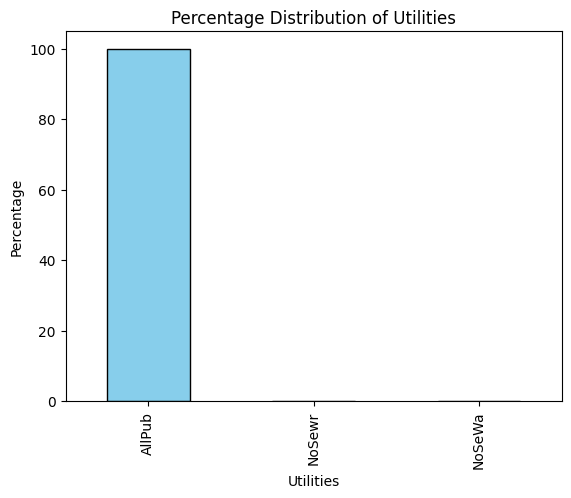

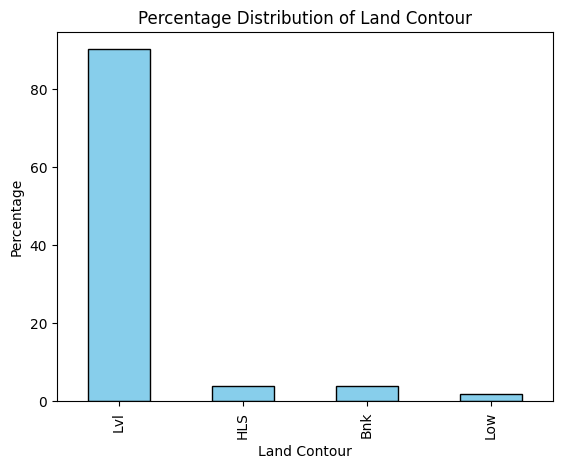

In [221]:
import matplotlib.pyplot as plt

# Assuming 'train' is your DataFrame

# Calculate the percentage distribution of each category in 'Utilities'
utilities_percentage = train['Utilities'].value_counts(normalize=True) * 100

# Plot the histogram
utilities_percentage.plot(kind='bar', color='skyblue', edgecolor='black')

# Add labels and title
plt.xlabel('Utilities')
plt.ylabel('Percentage')
plt.title('Percentage Distribution of Utilities')

# Show the plot
plt.show()


import matplotlib.pyplot as plt

# Assuming 'train' is your DataFrame

# Calculate the percentage distribution of each category in 'Utilities'
utilities_percentage = train['Land Contour'].value_counts(normalize=True) * 100

# Plot the histogram
utilities_percentage.plot(kind='bar', color='skyblue', edgecolor='black')

# Add labels and title
plt.xlabel('Land Contour')
plt.ylabel('Percentage')
plt.title('Percentage Distribution of Land Contour')

# Show the plot
plt.show()

Now since more than 90% of the data for both features are redundant, the features were decided to be dropped as they have no variability inside the features and thus will not be able to have a noticeable impact on the pricing of the houses. Moreover, a mistake that was done previously by not joining the two dataframes except the **'SalePrice'** which resulting in writing codes for cleaning the frames twice. This mistake is corrected in the following segment code which formed a joined dataframe named 'result_df'. Let us also confirm that there is not missing data in the joined dataframe.

In [222]:
train = train.drop(['Utilities','Land Contour'], axis=1)

test = test.drop(['Utilities','Land Contour'], axis=1)


print(train.shape[0])


print(test.shape[0])

ntrain=train.shape[0]

ntest=test.shape[0]



train_SalePrice=train['SalePrice']

train = train.drop(['SalePrice'], axis=1)

# Concatenate the two DataFrames along the rows
result_df = pd.concat([train, test], ignore_index=True)

result_df_na = (result_df.isnull().sum() / len(result_df)) * 100

#Dropped the indexes which contain no missing values
result_df_na = result_df_na.drop(result_df_na[result_df_na == 0].index).sort_values(ascending=False)
missing_data = pd.DataFrame({'Missing Ratio' :result_df_na})
missing_data.head()





2197
733


,Missing Ratio
Lot Frontage,0.102389


It can be seen that some portion of the **Lot Frontage** still do not have any info since there was not enough information that could be collected from the **'Neighborhood'** feature. So it was decided to fill those data with median of the column data 'Lot Frontage'. After that, the missing values were inspected again for confirmation and no missing data was found.

In [223]:
# Identify rows with missing values in the 'Lot Frontage' column
missing_lot_frontage = result_df[result_df['Lot Frontage'].isnull()]

#print(missing_lot_frontage)


lot_frontage_median = result_df['Lot Frontage'].median()


# Fill missing values in the 'Lot Frontage' column with the median
result_df['Lot Frontage'].fillna(lot_frontage_median, inplace=True)


result_df_na = (result_df.isnull().sum() / len(result_df)) * 100
result_df_na = result_df_na.drop(result_df_na[result_df_na == 0].index).sort_values(ascending=False)
missing_data = pd.DataFrame({'Missing Ratio': result_df_na})
missing_data.head()

,Missing Ratio


There are three feature columns which include information about **basement, 1st and 2nd floor area**. A **total square feet area** was calculated by summing all those information and a new feature was formed which included this data named as **'TotalSF'**. Moreover, values of certain columns were converted from 'object' to 'str'.

In [224]:
result_df['MS SubClass'] = result_df['MS SubClass'].apply(str)
result_df['Overall Cond'] = result_df['Overall Cond'].astype(str)
result_df['Yr Sold'] = result_df['Yr Sold'].astype(str)
result_df['Mo Sold'] = result_df['Mo Sold'].astype(str)

result_df['TotalSF'] = result_df['Total Bsmt SF'] + result_df['1st Flr SF'] + result_df['2nd Flr SF']
result_df


,Order,MS SubClass,MS Zoning,Lot Frontage,Lot Area,Street,Lot Shape,Lot Config,Land Slope,Neighborhood,Condition 1,Condition 2,Bldg Type,House Style,Overall Qual,Overall Cond,Year Built,Year Remod/Add,Roof Style,Roof Matl,Exterior 1st,Exterior 2nd,Mas Vnr Type,Mas Vnr Area,Exter Qual,Exter Cond,Foundation,Bsmt Qual,Bsmt Cond,Bsmt Exposure,BsmtFin Type 1,BsmtFin SF 1,BsmtFin Type 2,BsmtFin SF 2,Bsmt Unf SF,Total Bsmt SF,Heating,Heating QC,Central Air,Electrical,1st Flr SF,2nd Flr SF,Low Qual Fin SF,Gr Liv Area,Bsmt Full Bath,Bsmt Half Bath,Full Bath,Half Bath,Bedroom AbvGr,Kitchen AbvGr,Kitchen Qual,TotRms AbvGrd,Functional,Fireplaces,Garage Type,Garage Yr Blt,Garage Finish,Garage Cars,Garage Area,Garage Qual,Garage Cond,Paved Drive,Wood Deck SF,Open Porch SF,Enclosed Porch,3Ssn Porch,Screen Porch,Pool Area,Misc Val,Mo Sold,Yr Sold,Sale Type,Sale Condition,TotalSF
0,534,20,RL,80.0,9605,Pave,Reg,Corner,Gtl,SawyerW,Norm,Norm,1Fam,1Story,7,6,2007,2007,Gable,CompShg,VinylSd,VinylSd,None,0.0,Gd,TA,PConc,Gd,TA,No,Unf,0.0,Unf,0.0,1218.0,1218.0,GasA,Ex,Y,SBrkr,1218,0,0,1218,0.0,0.0,1,1,3,1,Gd,6,Typ,0,Detchd,2007.0,RFn,2.0,576.0,TA,TA,Y,0,178,0,0,0,0,0,4,2009,WD,Normal,2436.0
1,803,20,RL,90.0,14684,Pave,IR1,CulDSac,Gtl,SawyerW,Norm,Norm,1Fam,1Story,7,7,1990,1991,Hip,CompShg,HdBoard,HdBoard,BrkFace,234.0,Gd,TA,CBlock,Gd,TA,Mn,ALQ,485.0,BLQ,177.0,1496.0,2158.0,GasA,Gd,Y,SBrkr,2196,0,0,2196,0.0,0.0,2,0,3,1,Gd,7,Typ,1,Attchd,1990.0,RFn,3.0,701.0,TA,TA,Y,84,70,0,0,0,0,0,6,2009,WD,Normal,4354.0
2,956,20,RL,79.0,14375,Pave,IR1,CulDSac,Gtl,Timber,Norm,Norm,1Fam,SLvl,6,6,1958,1958,Gable,CompShg,HdBoard,HdBoard,BrkFace,541.0,TA,TA,CBlock,TA,TA,No,GLQ,111.0,Rec,354.0,354.0,819.0,GasA,Gd,Y,FuseA,1344,0,0,1344,0.0,1.0,1,0,3,1,Gd,7,Typ,1,Basment,1958.0,RFn,2.0,525.0,TA,TA,Y,0,118,0,0,233,0,0,1,2009,COD,Abnorml,2163.0
3,460,120,RL,48.0,6472,Pave,Reg,Inside,Gtl,NridgHt,Norm,Norm,TwnhsE,1Story,9,5,2008,2008,Hip,CompShg,VinylSd,VinylSd,BrkFace,500.0,Ex,TA,PConc,Ex,TA,No,Unf,0.0,Unf,0.0,1451.0,1451.0,GasA,Ex,Y,SBrkr,1456,0,0,1456,0.0,0.0,2,0,2,1,Ex,6,Typ,1,Attchd,2008.0,RFn,2.0,539.0,TA,TA,Y,192,42,0,0,0,0,0,4,2009,WD,Normal,2907.0
4,487,80,RL,61.0,9734,Pave,IR1,Inside,Gtl,Gilbert,RRAn,Norm,1Fam,SLvl,7,5,2004,2004,Gable,CompShg,VinylSd,VinylSd,None,0.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,241.0,Rec,113.0,30.0,384.0,GasA,Ex,Y,SBrkr,744,630,0,1374,0.0,0.0,2,1,3,1,Gd,7,Typ,0,BuiltIn,2004.0,Fin,2.0,400.0,TA,TA,Y,0,0,0,0,0,0,0,5,2009,WD,Normal,1758.0
5,1965,20,RL,70.0,7315,Pave,Reg,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,6,1958,1958,Hip,CompShg,BrkFace,BrkFace,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,625.0,Unf,0.0,545.0,1170.0,GasA,TA,Y,SBrkr,1170,0,0,1170,0.0,1.0,1,0,3,1,TA,6,Typ,1,Attchd,1958.0,RFn,1.0,338.0,TA,TA,Y,0,0,0,0,225,0,0,3,2007,WD,Normal,2340.0
6,681,20,RL,71.0,7350,Pave,Reg,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,6,1958,1958,Hip,CompShg,BrkFace,BrkFace,None,0.0,TA,TA,CBlock,TA,TA,No,Unf,0.0,Unf,0.0,1041.0,1041.0,GasA,Gd,Y,SBrkr,1041,0,0,1041,0.0,0.0,1,0,3,1,TA,6,Typ,0,Attchd,1958.0,RFn,1.0,294.0,TA,TA,Y,0,0,0,0,0,0,0,3,2009,WD,Normal,2082.0
7,1566,60,RL,74.0,11050,Pave,Reg,Inside,Gtl,Mitchel,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,Mn,Unf,0.0,Unf,0.0,910.0,910.0,GasA,Ex,Y,SBrkr,910,910,0,1820,0.0,0.0,2,1,3,1,Gd,8,Typ,1,Attchd,1996.0,Unf,3.0,816.0,TA,TA,Y,318,32,0,0,0,0,0,9,2008,WD,Normal,2730.0
8,419,20,RL,65.0,7150,Pave,Reg,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,5,1967,1967,Gable,CompShg,HdBoard,HdBoard,BrkFace,60.0,TA,TA,CBlock,TA,TA,No,BLQ,432.0,Unf,0.0,460.0,892.0,GasA,TA,Y,SBrkr,892,0,0,892,0.0,0.0,1,0,3,1,TA,5,Typ,0,Attchd,1967.0,RFn,1.0,288.0,TA,TA,Y,0,0,0,0,0,0,0,7,2009,WD,Normal,1784.0
9,2346,60,RL,80.0,18800,Pave,IR1,FR2,Gtl,NWAmes,Norm,Norm,1Fam,2Story,6,5,1976,1976,Gable,CompShg,HdBoard,HdBoard,BrkFace,120.0,TA,TA,PConc,Gd,TA,Mn,GLQ,712.0,Unf,0.0,84.0,796.0,GasA,TA,Y,SBrkr,790,784,0,1574,1.0,0.0,2,1,3,1,TA,6,Typ,1,Attchd,1976.0,Fin,2.0,566.0,TA,TA,Y,306,111,0,0,0,0,0,7,2006,WD,Normal,2370.0


On this step, the 'SalePrice' target column was joined for both train and test dataframe and a final combined dataframe named as 'df' was formed from unification of 'result_df' and 'SalePrice' for all the train and test samples. The 'SalePrice' of the test dataset was read from the 'target.csv' file since it was unavailable on the respective 'test.csv'

In [225]:
# df = result_df[:ntrain].copy()  # create a copy to avoid SettingWithCopyWarning
# df['SalePrice'] = train_SalePrice

# result_df.to_csv('clean_result_df-hpp.csv', index=False)
# df.to_csv('clean_train-hpp.csv', index=False)
# df.head()

# df.shape


# print(train_SalePrice)


target_SalePrice=pd.read_csv('/content/target.csv')

test=target_SalePrice.SalePrice



final_target=pd.concat([train_SalePrice,test],axis=0)

final_target.shape

# Reset index for both DataFrames
#result_df = result_df.reset_index(drop=True)

final_target = final_target.reset_index(drop=True)

# Concatenate DataFrames along the columns (axis=1)
df = pd.concat([result_df, final_target], axis=1)

df

df.to_csv('clean_train_test-hpp.csv', index=False)

# print(result_df.columns.tolist())

# print(type(final_target))

df.head()


df.shape



(2930, 75)

Next, the features which have more than 50 percent  correlation with 'SalePrice' were determined to have an idea.

In [226]:
corrmat = df.corr()
def get_correlated_features(corrdata, threshold):
    feature = []
    value = []
    for i , index in enumerate(corrdata.index):
        if abs(corrdata[index]) > threshold:
            feature.append(index)
            value.append(corrdata[index])
    df2 = pd.DataFrame(data = value, index=feature, columns=['corr value'] )
    return df2
corr_df = get_correlated_features(corrmat['SalePrice'], 0.5)
corr_df=corr_df.sort_values(by=['corr value'],ascending=False)

corr_df

<ipython-input-226-c5aa5d9f92ed>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corrmat = df.corr()


,corr value
SalePrice,1.000000
Overall Qual,0.799262
TotalSF,0.793127
Gr Liv Area,0.706780
Garage Cars,0.647562
Garage Area,0.640138
Total Bsmt SF,0.632529
1st Flr SF,0.621676
Year Built,0.558426
Full Bath,0.545604


It can be seen that 11 features were found to be highly correlated with house pricing. We can check those feature columns at a glance:

In [227]:
correlated_data = df[corr_df.index]
correlated_data.head()

,SalePrice,Overall Qual,TotalSF,Gr Liv Area,Garage Cars,Garage Area,Total Bsmt SF,1st Flr SF,Year Built,Full Bath,Year Remod/Add,Mas Vnr Area
0,159000,7,2436.0,1218,2.0,576.0,1218.0,1218,2007,1,2007,0.0
1,271900,7,4354.0,2196,3.0,701.0,2158.0,2196,1990,2,1991,234.0
2,137500,6,2163.0,1344,2.0,525.0,819.0,1344,1958,1,1958,541.0
3,248500,9,2907.0,1456,2.0,539.0,1451.0,1456,2008,2,2008,500.0
4,167000,7,1758.0,1374,2.0,400.0,384.0,744,2004,2,2004,0.0


Now let us plot a heatmap of these highly correlated features to have an idea of the factors that influence house pricing.

<Axes: >

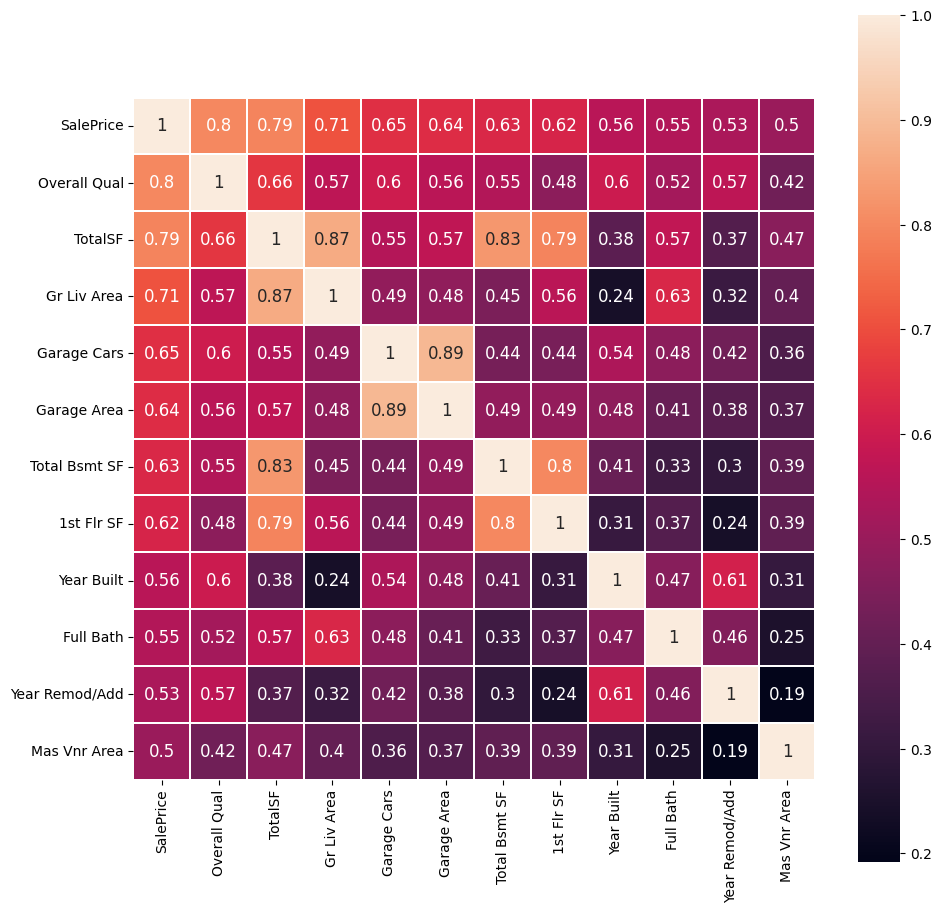

In [228]:
import seaborn as sns

fig, ax = plt.subplots(figsize=(11, 11))
sns.heatmap(correlated_data.corr(), annot = True, annot_kws={'size': 12}, square=True, linecolor='w', linewidths=0.1)

From the heatmap, it can be observed that **overall quality of  material and finish** was the most correlated feature on house pricing. The newly synthesized feature **'TotalSF'** which refers as total square feet area also came to second most correlated feature to house pricing.. The **general living area, garage area** were also found to be very important correlated feature behind price change of house pricing.

Since the processing of data has been almost completed, let us check the distribution of the target **'SalePrice'** before we start analysis.

<ipython-input-229-a3f16bd525ad>:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df['SalePrice'] , fit=norm);


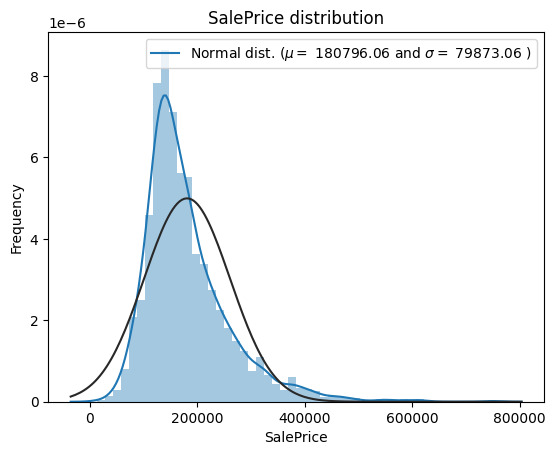

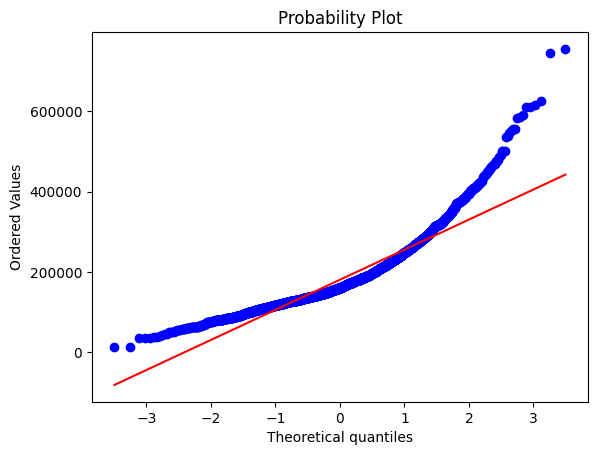

In [229]:
from scipy import stats
from scipy.stats import norm, skew
import matplotlib.pyplot as plt
import numpy as np


sns.distplot(df['SalePrice'] , fit=norm);
(mu, sigma) = norm.fit(df['SalePrice'])
plt.legend(['Normal dist. ($\mu=$ {:.2f} and $\sigma=$ {:.2f} )'.format(mu, sigma)],
            loc='best')
plt.ylabel('Frequency')
plt.title('SalePrice distribution')
fig = plt.figure()
res = stats.probplot(df['SalePrice'], plot=plt)
plt.show()

It seems that the **"SalePrice"** column is highly right skewed and the probability plot is hardly linear which might have a negative impact on data analysis with visualization later. Let us make the distribution normal with logarithmic transformation which also results in making the probability plot linear and good for visualization analysis.

<ipython-input-240-617b61d0c980>:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df['SalePrice'] , fit=norm);


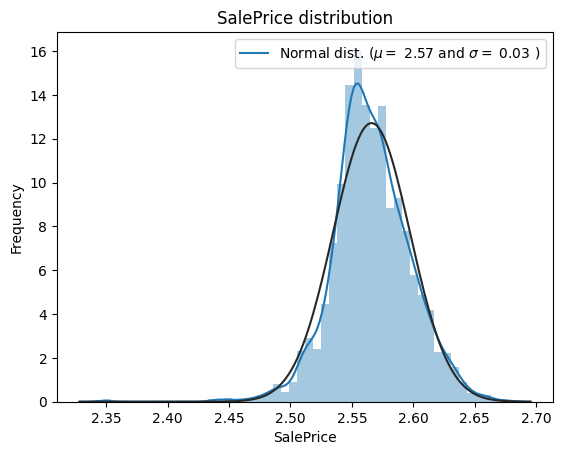

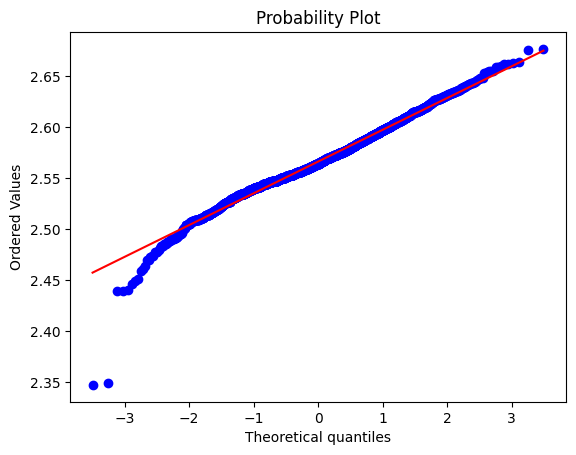

array(['Order', 'MS SubClass', 'MS Zoning', 'Lot Frontage', 'Lot Area',
       'Street', 'Lot Shape', 'Lot Config', 'Land Slope', 'Neighborhood',
       'Condition 1', 'Condition 2', 'Bldg Type', 'House Style',
       'Overall Qual', 'Overall Cond', 'Year Built', 'Year Remod/Add',
       'Roof Style', 'Roof Matl', 'Exterior 1st', 'Exterior 2nd',
       'Mas Vnr Type', 'Mas Vnr Area', 'Exter Qual', 'Exter Cond',
       'Foundation', 'Bsmt Qual', 'Bsmt Cond', 'Bsmt Exposure',
       'BsmtFin Type 1', 'BsmtFin SF 1', 'BsmtFin Type 2', 'BsmtFin SF 2',
       'Bsmt Unf SF', 'Total Bsmt SF', 'Heating', 'Heating QC',
       'Central Air', 'Electrical', '1st Flr SF', '2nd Flr SF',
       'Low Qual Fin SF', 'Gr Liv Area', 'Bsmt Full Bath',
       'Bsmt Half Bath', 'Full Bath', 'Half Bath', 'Bedroom AbvGr',
       'Kitchen AbvGr', 'Kitchen Qual', 'TotRms AbvGrd', 'Functional',
       'Fireplaces', 'Garage Type', 'Garage Yr Blt', 'Garage Finish',
       'Garage Cars', 'Garage Area', 'Garage Qual'

In [240]:
df["SalePrice"] = np.log1p(df["SalePrice"])

sns.distplot(df['SalePrice'] , fit=norm);
(mu, sigma) = norm.fit(df['SalePrice'])
plt.legend(['Normal dist. ($\mu=$ {:.2f} and $\sigma=$ {:.2f} )'.format(mu, sigma)],
            loc='best')
plt.ylabel('Frequency')
plt.title('SalePrice distribution')
fig = plt.figure()
res = stats.probplot(df['SalePrice'], plot=plt)
plt.show()



# Analysis (Bivariate) :

We start the analysis with visualizing relationships between **'SalePrice'** and another feature under experiment. Let us first choose the most correlated variable feauter with the target data named as 'Overall Qual'. A scatterplot is generated with a best fitted regression line model betweel  **'SalePrice'** vs **'Overall Qual'**.



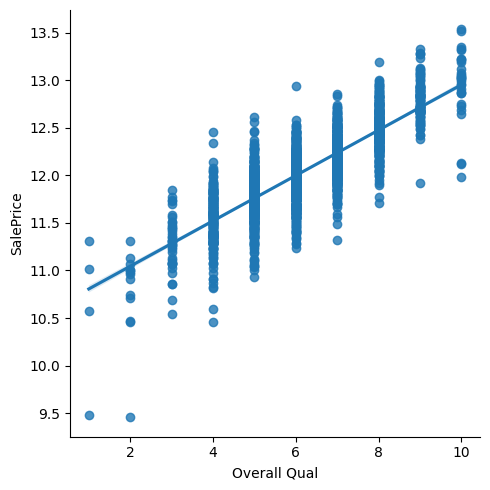

In [232]:
import seaborn as sns
sns.lmplot(y='SalePrice',x='Overall Qual',data=df)

The scatter points represent individual data samples and the regression line represent an average estimation over the relationship between twa variables. As can be seen from both, there is clearly linear relatiohship between overall quality ratings with pricing of house since with increase of quality the price also seems to increase in a linear manner.

Let us investigate the relationship between pricing and another highly correlated feature **'Garage Area'**. A joint plot is used to demonstrate both univariate and bivariate plot of variables. The bivariate plot uses a scatterplot and the univariate histograms show distribution of individual features.

<function matplotlib.pyplot.show(close=None, block=None)>

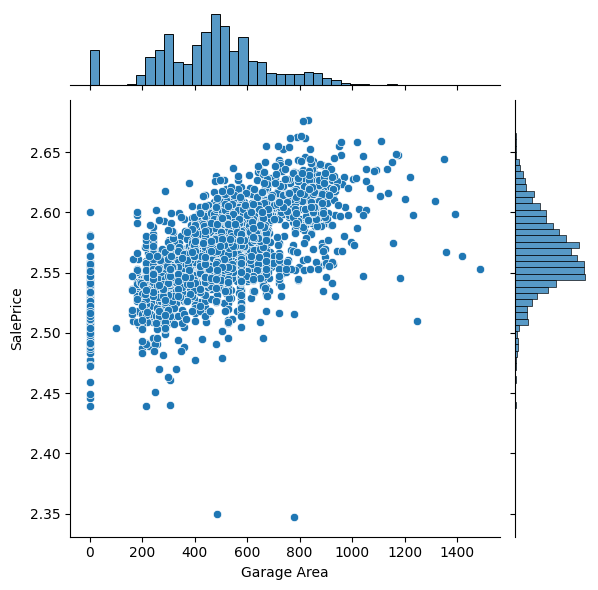

In [241]:
import seaborn as sns

sns.jointplot(y='SalePrice',x='Garage Area',data=df)

plt.show

From the above plot, it can be observed that price of houses has linear positive correlation with garage area size. The scatterplot is also pretty congested in a cluster which represents high correlation while there are some outliers around the plot.The Garage area distribution data seems to be skewed towards increased garage area. The 'SalePrice' distribution seems to be skewed towards lower price range representing there is not many samples in the dataset in relatively lower price range.

Now, let us witness the relation between a variable **'Yr Sold'** which represents the time period when the properties were sold and **'SalePrice'**. A scatterplot with jointplot is generated to understand the relationship

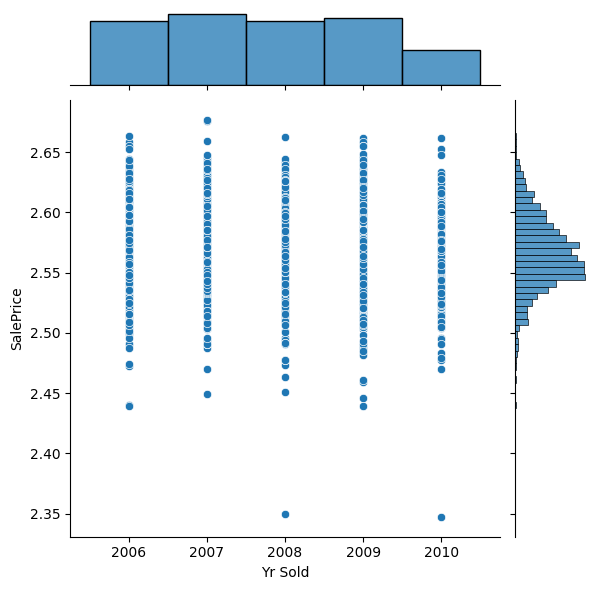

In [243]:
import seaborn as sns

df_sorted = df.sort_values(by='Yr Sold',ascending=True)

sns.jointplot(y='SalePrice', x='Yr Sold', data=df_sorted)


As can be seen from the plot, there is no special relation between the price of the house and the time in which they were sold. It can be noticed from the distribution of 'Yr Sold' that the number of properties sold in 2010 decreased drastically after the end of recession which lasted from 2007 to 2009. It was also seen that the outliers in 2010 for pricing of houses were comparitively lower than the other years which signifies that people stopped selling the houses in discounted prices as the recession was over. But no significant relation with house pricing increase was seen over the years plotted from the dataset.

Let us examine now the contruction or remodelling period **'Year Remod/Add'** relationship with pricing. A linear regression model line with scatterplot is plotted below :

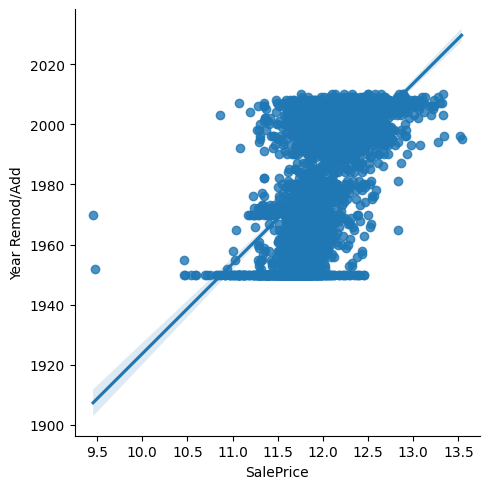

In [234]:
sns.lmplot(x='SalePrice', y='Year Remod/Add', data=df)

It was noticed that there is almost a linear relationship with construction/remodelling year with pricing. I did not actually expect to see a relation here. Seems that period of the sale year has less impact on price of houses than period of construction/remodelling. The more 'recent' the construction/remodelling is, the higher the price.

After this, we plot the relationship between pricing and number of bathroom in houses named as **'Full Bath'**. Let us examine the relationship by generating a strip plot :

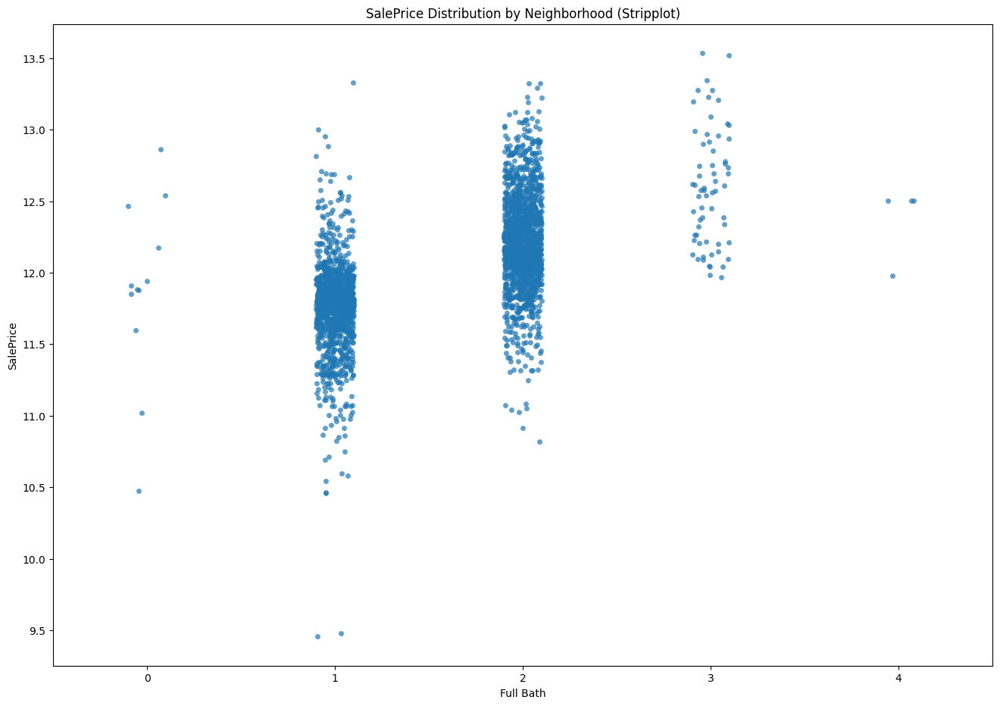

In [235]:
import matplotlib.pyplot as plt

# Create a stripplot or swarmplot
plt.figure(figsize=(16, 11))  # Adjust the figure size if needed

# Stripplot
sns.stripplot(x='Full Bath', y='SalePrice', data=df, jitter=True, alpha=0.7)

plt.title('SalePrice Distribution by Neighborhood (Stripplot)')
plt.show()

The above plot suggests that the pricing generally increases with the inceased number of bathroom in apartments largely upto count of 3. After that, more number of bathroom increase does not impact the pricing significantly.

Next, I wanted to investigate the **neighborhood locations** of the properties and their impact on pricing. For this reason, another strip plot is formed :


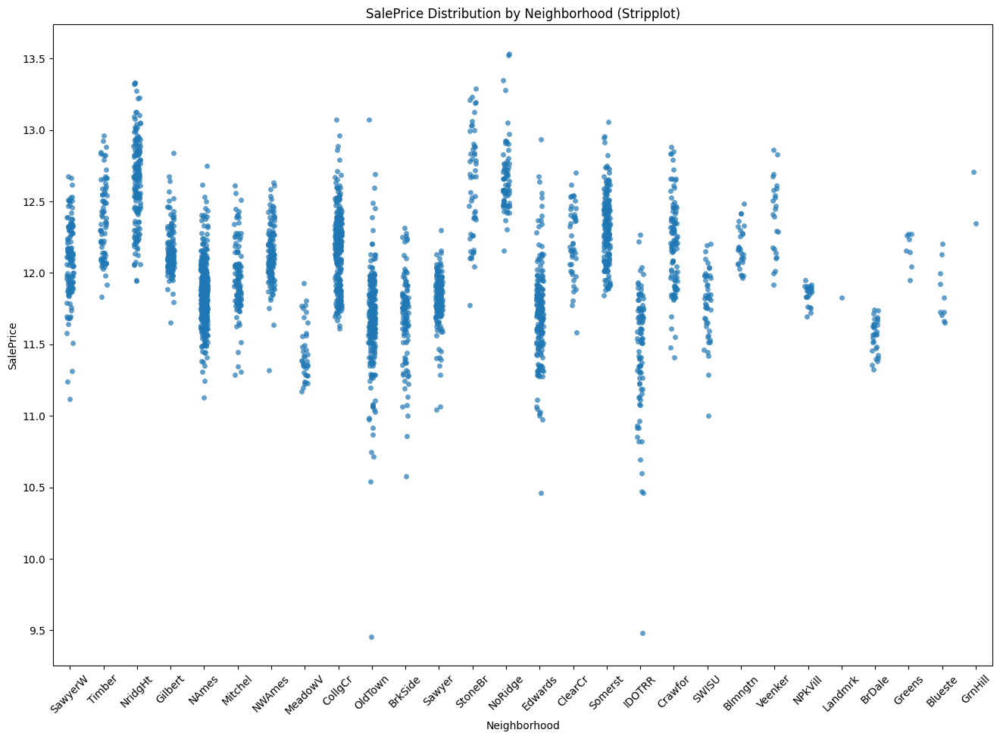

In [236]:
import seaborn as sns
import matplotlib.pyplot as plt

# Create a stripplot or swarmplot
plt.figure(figsize=(16, 11))  # Adjust the figure size if needed

# Stripplot
sns.stripplot(x='Neighborhood', y='SalePrice', data=df, jitter=True, alpha=0.7)
plt.xticks(rotation=45)  # Rotate x-axis labels for better visibility
plt.title('SalePrice Distribution by Neighborhood (Stripplot)')
plt.show()

From the plot it can be estimated that, neighborhood does have a significant impact on the pricing of the homes. Although there are outliers in most of the neighborhood, the in general most of the properties remain at similar price range for individual neighborhoods. As the samples are almost clustered very closely, it can be measured that the neighborhood within high price range, has most of the properties in expensive region whereas neighborhoods with relatively medium or lower price ranges has majority samples of it in medium or lower price region respectively.

I was also curious to analyze the relation between **garage year** period and pricing. So I plotted their relationship and found that it was highly negatively correlated and hence no trend could be explained.

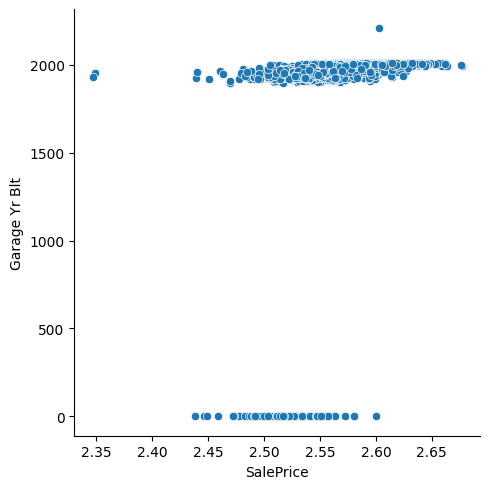

In [244]:
sns.relplot(x='SalePrice', y='Garage Yr Blt', data=df)

# Multivariate plots

Let us now examine relationship among more than two variables. A bubble plot among **total square feet area, price and living area size** was generated where all of these features have proven to be highly correlated with each other.

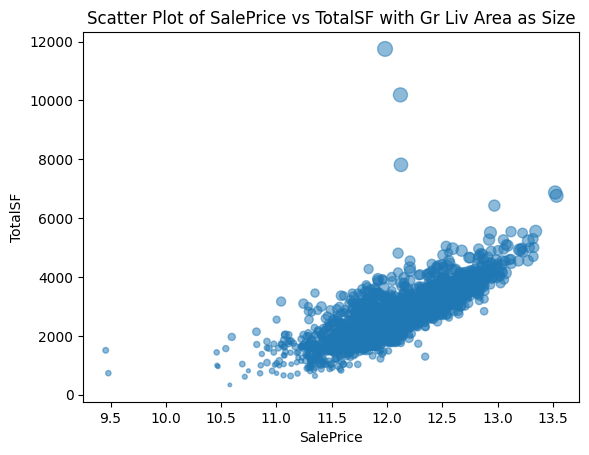

In [237]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.scatter(x=df['SalePrice'], y=df['TotalSF'],s=df['Gr Liv Area']/50,alpha=.5)




plt.title('Scatter Plot of SalePrice vs TotalSF with Gr Liv Area as Size')
plt.xlabel('SalePrice')
plt.ylabel('TotalSF')
plt.show()

It can be seen that there is clearly a  linearly relation between total square feet area and pricing of the house as the bubbles are clustered in a congested location signifying the high correlation and their increase of position in vertical axis with the increase of price. Also, it can also be observed that lower living space results in lower price and higher living space size causes higher prices since the bubbles sizes represent the living area size. It can also be noticed that some of the properties with highest living area, still could not make the pricing highest, which can be regarded as an outlier.

Now let us consider other two highly correalted features as **overall quality rating and garage car number** and plot their relationship with a linear regression model fit :

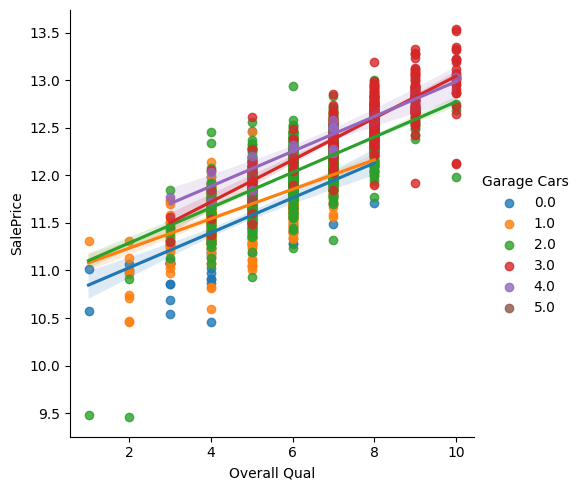

In [238]:
sns.lmplot(x='Overall Qual', y='SalePrice', data=df, hue= 'Garage Cars')

The above plot represent the linear regression model fit between 'SalePrice' and 'Overall Qual' on the basis of data grouped by 'Garage Cars' which is represented by different colors. As the plot seems to be almost vague to understand, it was broken into several individual plots below :

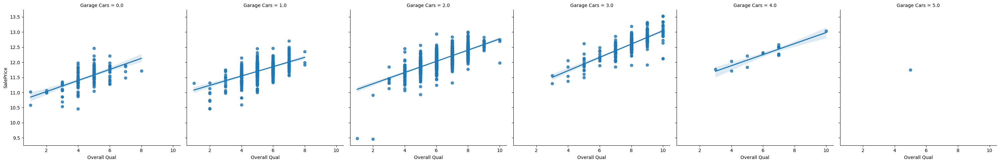

In [239]:
sns.lmplot(x='Overall Qual', y='SalePrice', data=df, col= 'Garage Cars')

It can be noticed that the scatterpoints are moving towards right with the increase of garage car number, which represents the increase of quality rating of house with it's garage car capacity. The exception was for garage cars=4 where the quality was not higher than the previous case. The uncertainty of the linear model can also be noted as there are not sufficient samples to make the regression line fit. For garage cars=5 there is only one sample making it unusable to estimate or learn something from that plot.

#Report :

In this project,  impacts of various factors were explored over house pricing. After investigation, the highest correlated features with 'SalePrice' were found to be overall quality rating, total square feet area, living area size and garage car capacity. It was also found that some of the features like year of construction/remodelling, bathroom-count and neighborhood have partial impact on the pricing of houses. Some of features which were seemed to have no signifant impact or highly negative correlated with pricing were saling period of properties and year when garage was built.

Thus, the investigation ends here. More feature inspection can be done later extensively with more data inclusion and feature relationship research if necessary.

